# **Capstone Project - Dog Breed Classification & Object Detection**
**Woojong Choi**

**Task 2**: Build an object detection model to identify a specific dog breed, Norwich Terriers, within images and videos. The success criteria for the object detection model include achieving a mean Average Precision at IoU threshold 0.50 (mAP50) score of 0.80 or higher.

## **Object Detection**
## YOLOv8

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#### Imports and installations

In [2]:
# installation for YOLOv8

!pip install ultralytics==8.0.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 219.8/219.8 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.5/189.5 kB 23.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 16.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 83.3 MB/s eta 0:00:00
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144554 sha256=135511353c599ddca9cb167b86604255142703a2c10dda94928f6d35527cf638
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127edc45659556564c5730f6d4e300888f4bca2d4c5a88
Successfully built antlr4-python3-runtime


In [3]:
# Images are annotated using Roboflow. Installing roboflow to download annotated data.

!pip install roboflow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.7/58.7 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 23.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 38.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 8.2 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.0.76
    Uninstalling opencv-python-headless-4.8.0.76:
      Successfully uninstalled 

In [4]:
import matplotlib.pyplot as plt
from IPython.display import Image, HTML, display
from base64 import b64encode
import os
import glob
import torch
import ultralytics
from roboflow import Roboflow

In [5]:
torch.cuda.is_available()

True

In [6]:
!nvidia-smi

Mon Sep 18 19:16:42 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8     9W /  70W |      3MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [7]:
torch.__version__

'2.0.1+cu118'

### YOLOv8: pre-trained model

#### Image obeject detection using a pre-trained YOLOv8s model to detect dogs

In [ ]:
!yolo task=detect mode=predict model=yolov8s.pt source='/content/drive/MyDrive/general_assembly/capstone/image/sample1.jpg'

2023-09-13 19:36:08.470189: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-13 19:36:09.541026: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
100% 21.5M/21.5M [00:00<00:00, 143MB/s] 

Fusing layers... 
YOLOv8s summary: 168 layers, 11156544 parameters, 0 gradients, 28.6 GFLOPs
image 1/1 /content/drive/MyDrive/general_assembly/capstone/image/sample1.jpg: 640x608 1 dog, 70.0ms
Speed: 0.7ms pre-process, 70.0ms inference, 51.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict


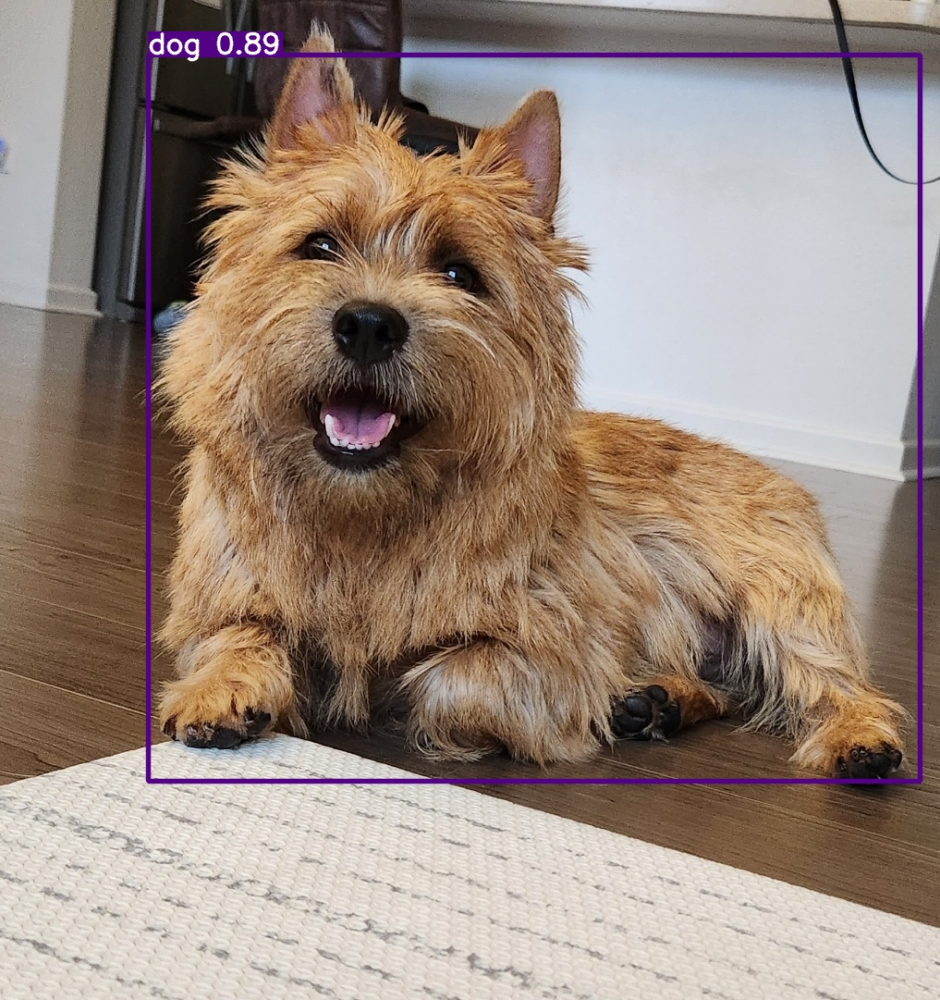

In [ ]:
image_path = '/content/runs/detect/predict/sample1.jpg'
display(Image(image_path, width=300))

In [ ]:
!yolo task=detect mode=predict model=yolov8s.pt source='/content/drive/MyDrive/general_assembly/capstone/image/sample2.jpg'

2023-09-13 19:38:01.944764: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-13 19:38:03.043752: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
YOLOv8s summary: 168 layers, 11156544 parameters, 0 gradients, 28.6 GFLOPs
image 1/1 /content/drive/MyDrive/general_assembly/capstone/image/sample2.jpg: 384x640 2 dogs, 71.1ms
Speed: 0.6ms pre-process, 71.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict2


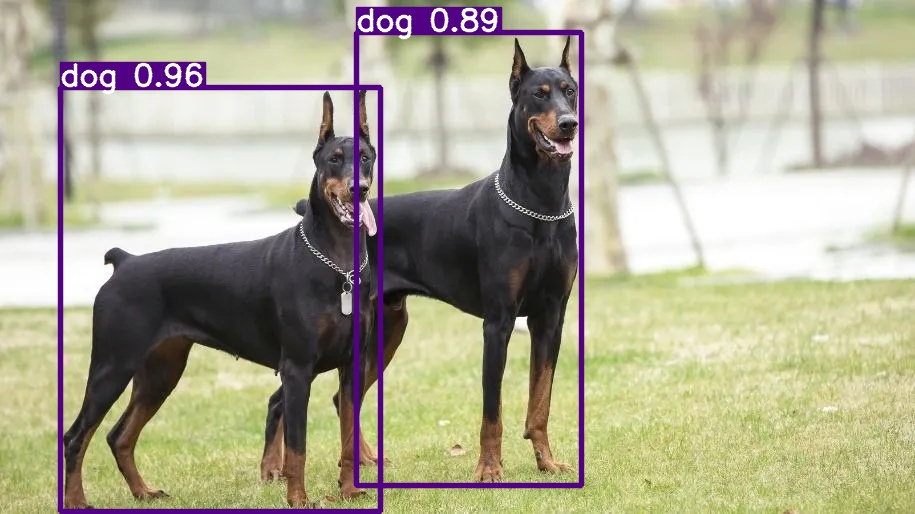

In [ ]:
image_path = '/content/runs/detect/predict2/sample2.jpg'
display(Image(image_path, width=300))

#### Video object detection
- yolov8s

In [ ]:
!yolo task=detect mode=predict model=yolov8s.pt source='/content/drive/MyDrive/general_assembly/capstone/video/20230902_133207.mp4'

2023-09-13 19:41:52.517221: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-13 19:41:53.654303: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
YOLOv8s summary: 168 layers, 11156544 parameters, 0 gradients, 28.6 GFLOPs
video 1/1 (1/196) /content/drive/MyDrive/general_assembly/capstone/video/20230902_133207.mp4: 640x384 2 dogs, 86.0ms
video 1/1 (2/196) /content/drive/MyDrive/general_assembly/capstone/video/20230902_133207.mp4: 640x384 2 dogs, 1 chair, 11.1ms
video 1/1 (3/196) /content/drive/MyDrive/general_assembly/capstone/video/20230902_133207.mp4: 640x384 2 dogs, 11.1ms
video 1/1 (4/196) /conten

In [ ]:
# reference:
# https://www.youtube.com/watch?v=Rwvd0PJF2jk
# https://stackoverflow.com/questions/57377185/how-play-mp4-video-in-google-colab

# Input video path
save_path = '/content/runs/detect/predict3/20230902_133207.mp4'

# Compressed video path
compressed_path = "/content/drive/MyDrive/general_assembly/capstone/assets/obj_det_pt_video.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

The pretrained Yolov8 model is able to detect dogs (and people) with high accuracy from both images and videos.

### YOLOv8: training on custom data - Norwich Terrier Detector **Version 1**
- Model used: yolov8m

The custom dataset was annotated using *Roboflow*
- https://roboflow.com/
- Originally 152 images of Norwich Terriers and Beagles
- 364 total number of images after data augmentation

In [ ]:
HOME = '/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data'

In [ ]:
%cd {HOME}

/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data


In [ ]:
# Loading custom dataset annotated done using RoboFlow

%cd {HOME}/data

rf = Roboflow(api_key="-------") # api_key deleted
project = rf.workspace("school-xbwdb").project("norwich-terrier-detector")
dataset = project.version(2).download("yolov5")

/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/data
loading Roboflow workspace...
loading Roboflow project...

Version export complete for yolov5pytorch format



Extracting Dataset Version Zip to Norwich-Terrier-Detector-2 in yolov5pytorch:: 100%|██████████| 740/740 [00:03<00:00, 246.00it/s]


In [ ]:
%cd {HOME}

/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data


In [ ]:
# Training yolov8m model on custom data

!yolo task=detect mode=train model=yolov8m.pt data=/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/data/Norwich-Terrier-Detector/data.yaml epochs=70 imgsz=640

yolo/engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/data/Norwich-Terrier-Detector/data.yaml, epochs=70, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=False, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, retina_masks=False, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=17, workspace=4, nms=False, lr0=0

The model scored an impressive score of mAP50 - 0.949 for Norwich Terriers.

In [ ]:
!ls /content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/runs/detect/train2

args.yaml					    train_batch0.jpg
confusion_matrix.png				    train_batch1200.jpg
events.out.tfevents.1694717474.fd84cc7738e0.5727.0  train_batch1201.jpg
F1_curve.png					    train_batch1202.jpg
P_curve.png					    train_batch1.jpg
PR_curve.png					    train_batch2.jpg
predictions.json				    val_batch0_labels.jpg
R_curve.png					    val_batch0_pred.jpg
results.csv					    weights
results.png


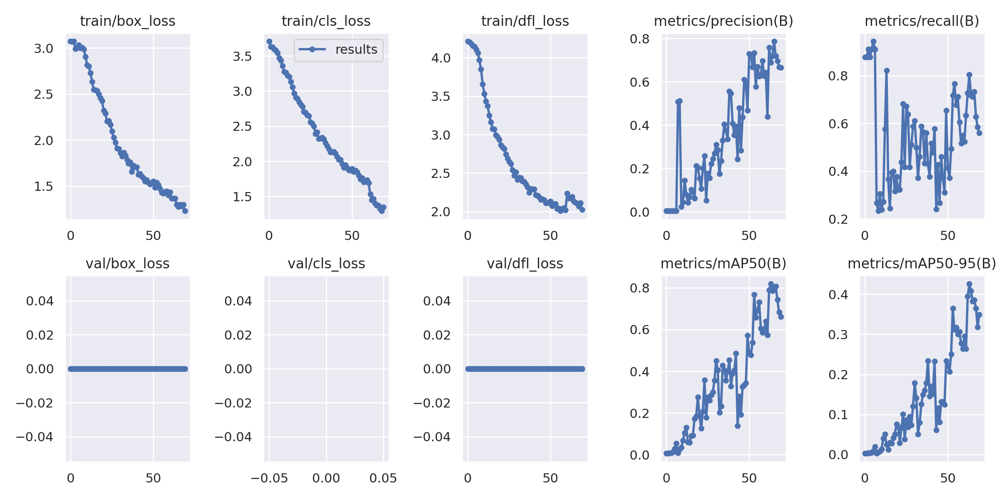

In [ ]:
Image(filename='/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/runs/detect/train2/results.png')

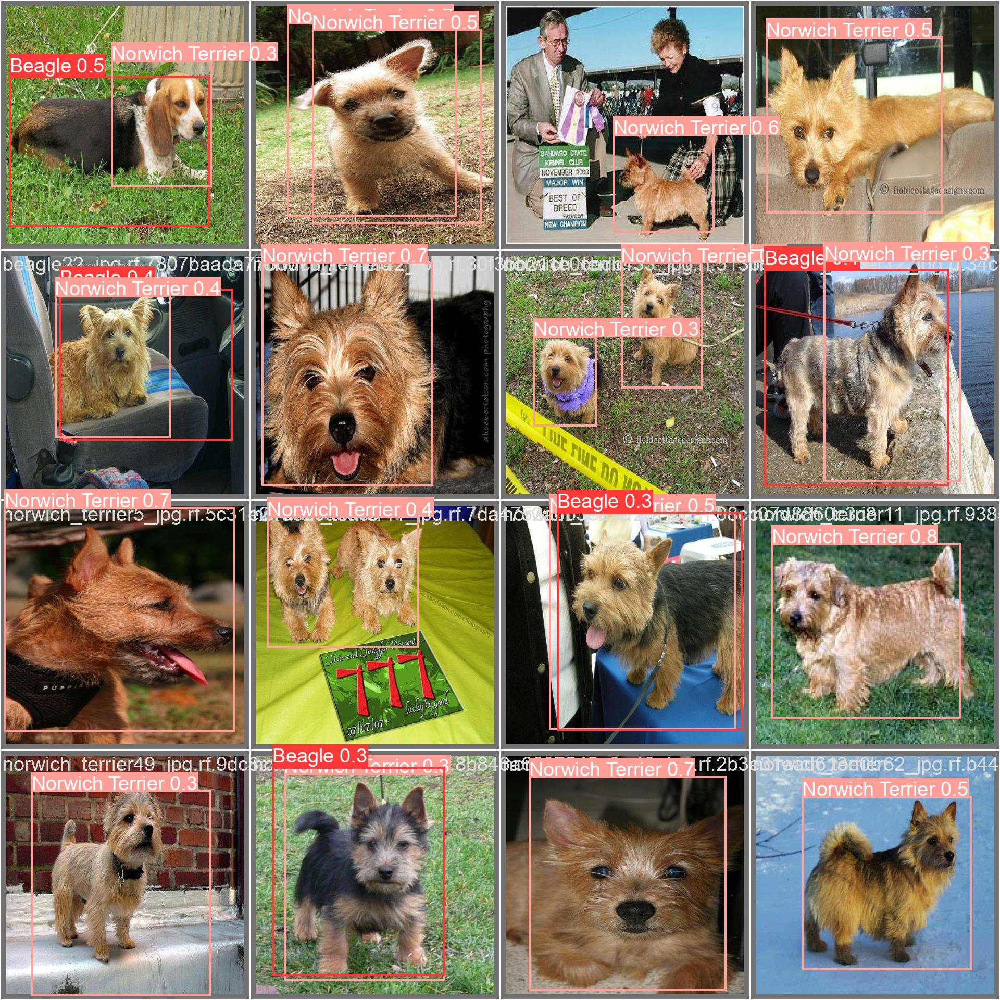

In [ ]:
# model predictions on validation images

Image(filename='/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/runs/detect/train2/val_batch0_pred.jpg')

In [ ]:
# testing model on test dataset

%cd {HOME}

!yolo task=detect mode=/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/runs/detect/train2/weights/best.pt conf=0.25 source=/content/drive/MyDrive/general_assembly/capstone/obejct_detection_customer_data/data/Norwich-Terrier-Detector/test/images

/content/drive/MyDrive/general_assembly/capstone/obejct_detection_customer_data
2023-09-13 21:43:13.845252: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-13 21:43:14.990763: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
Model summary: 218 layers, 25840918 parameters, 0 gradients, 78.7 GFLOPs
image 1/15 /content/drive/MyDrive/general_assembly/capstone/obejct_detection_customer_data/data/Norwich-Terrier-Detector/test/images/beagle100_jpg.rf.25af48e76199cf0b69c10bae3b436192.jpg: 640x640 1 Beagle, 37.0ms
image 2/15 /content/drive/MyDrive/general_assembly/capstone/obejct_detection_customer_data/dat

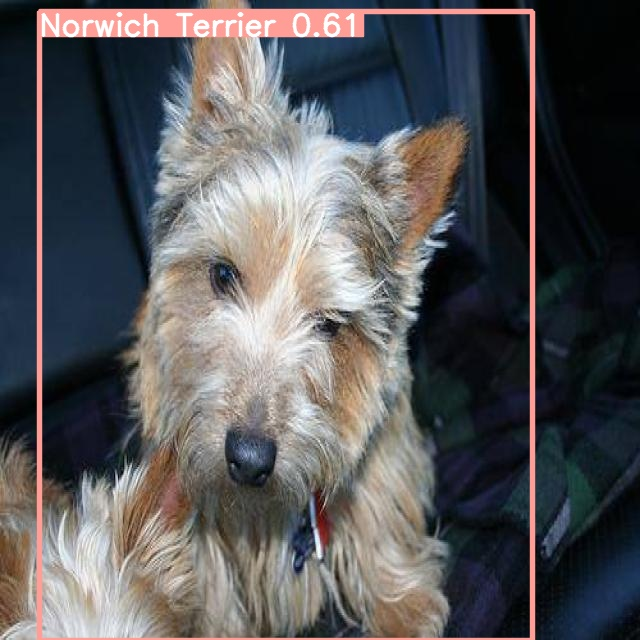

In [ ]:
# displaying predictions made on test images

Image('/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/runs/detect/predict/norwich_terrier74_jpg.rf.793129211638d40e804eaf48dd572005.jpg')

In [ ]:
# making prediction on an image

!yolo task=detect mode=predict model=/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/runs/detect/train/weights/best.pt conf=0.25 source=/content/drive/MyDrive/general_assembly/capstone/image/sample1.jpg

2023-09-13 21:50:38.805231: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-13 21:50:39.944690: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
Model summary: 218 layers, 25840918 parameters, 0 gradients, 78.7 GFLOPs
image 1/1 /content/drive/MyDrive/general_assembly/capstone/image/sample1.jpg: 640x608 2 Norwich Terriers, 72.2ms
Speed: 0.7ms pre-process, 72.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict2


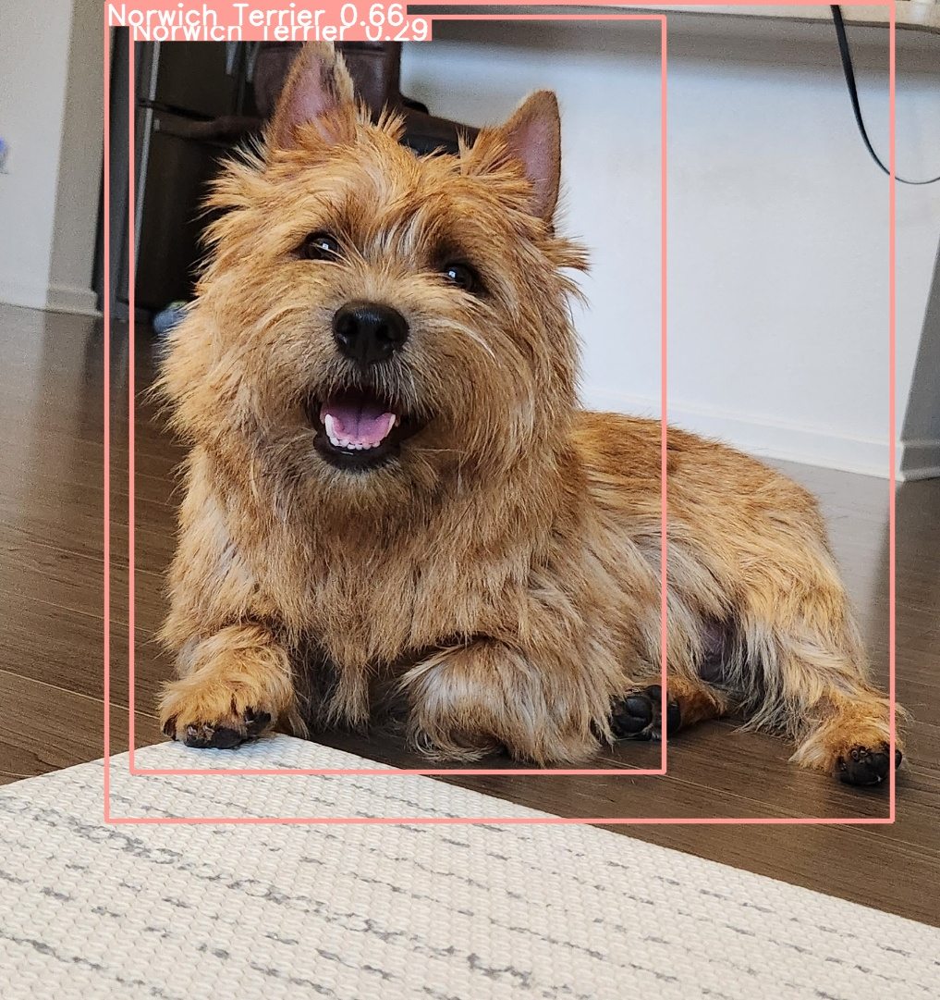

In [ ]:
# displaying image

Image('/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/runs/detect/predict2/sample1.jpg', width=400)

In [ ]:
# making prediction on video

!yolo task=detect mode=predict model=/content/drive/MyDrive/general_assembly/capstone/obejct_detection_custom_data/runs/detect/train/weights/best.pt conf=0.25 source=/content/drive/MyDrive/general_assembly/capstone/video/sample2_for_customer_data.mp4

2023-09-13 21:54:00.125024: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-13 21:54:01.284201: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
Model summary: 218 layers, 25840918 parameters, 0 gradients, 78.7 GFLOPs
video 1/1 (1/115) /content/drive/MyDrive/general_assembly/capstone/video/sample2_for_customer_data.mp4: 640x384 75.5ms
video 1/1 (2/115) /content/drive/MyDrive/general_assembly/capstone/video/sample2_for_customer_data.mp4: 640x384 25.3ms
video 1/1 (3/115) /content/drive/MyDrive/general_assembly/capstone/video/sample2_for_customer_data.mp4: 640x384 25.2ms
video 1/1 (4/115) /content/dri

In [2]:
#### Output deleted to reduce file size ####



# save_path = '/content/drive/MyDrive/general_assembly/capstone/obejct_detection_customer_data/runs/detect/predict3/sample2_for_customer_data.mp4'

# compressed_path = "/content/drive/MyDrive/general_assembly/capstone/assets/obj_det_cd_video.mp4"

# os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# mp4 = open(compressed_path,'rb').read()
# data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# HTML("""
# <video width=400 controls>
#       <source src="%s" type="video/mp4">
# </video>
# """ % data_url)

The initial model, trained on Norwich Terrier and Beagle images, performed well on images but failed to correctly identify a Norwich Terrier in a video.

### YOLOv8: training on custom data - Norwich Terrier Detector **Version 2**
- Model used: yolov8l
- Originally 211 new images of Norwich Terriers. 507 final number of images with data augementation.
- train: 444 images
- validation: 42 images
- test: 21 images

In [ ]:
HOME = '/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2'

In [ ]:
%cd {HOME}

/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2


In [ ]:
# Loading custom dataset annotated done using RoboFlow

%cd {HOME}/data

rf = Roboflow(api_key="-------") # api_key deleted
project = rf.workspace("school-xbwdb").project("norwich-terrier-detection")
dataset = project.version(1).download("yolov5")

/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/data
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to norwich-terrier-detection-1 in yolov5pytorch:: 100%|██████████| 1026/1026 [00:04<00:00, 239.87it/s]


In [ ]:
%cd {HOME}

/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2


In [ ]:
# Training yolov8m model on custom data - yolov8l

!yolo task=detect mode=train model=yolov8l.pt data=/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/data/norwich-terrier-detection/data.yaml epochs=100 imgsz=640

100% 83.7M/83.7M [00:05<00:00, 16.5MB/s]

yolo/engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/data/norwich-terrier-detection/data.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=False, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, retina_masks=False, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify

The second iteration achieved an impressive mAP50 value of 0.947

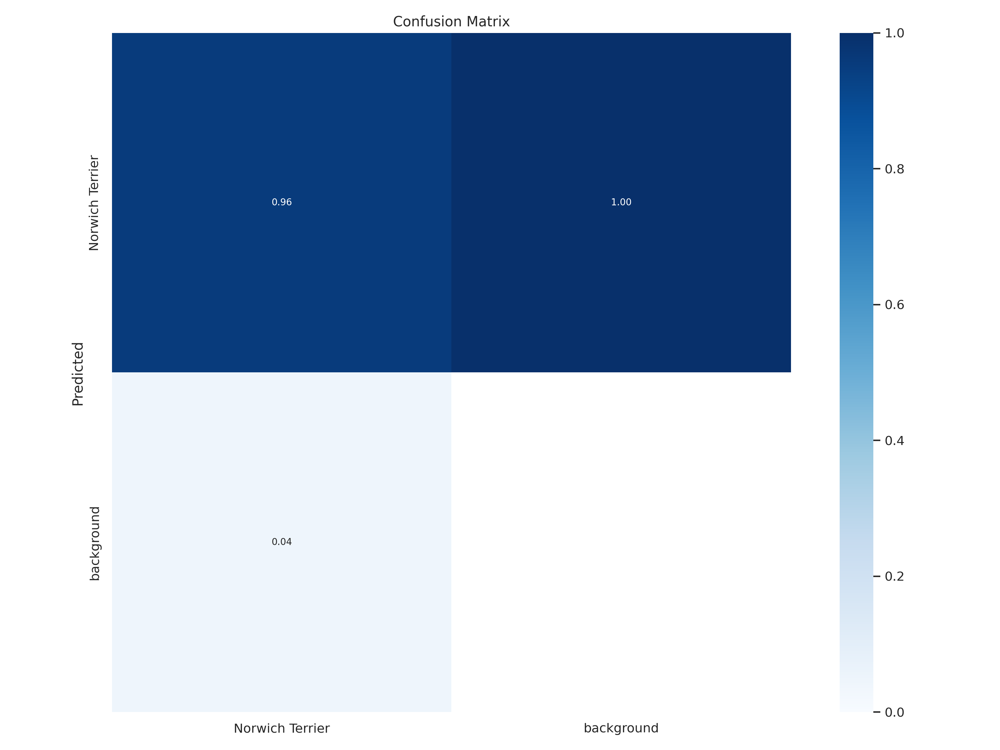

In [ ]:
Image(filename='/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/runs/detect/train/confusion_matrix.png', width=600)

The confusion matrix further validates the model's performance. It can accurately detect and isolate Norwich Terriers with very high accuracy.

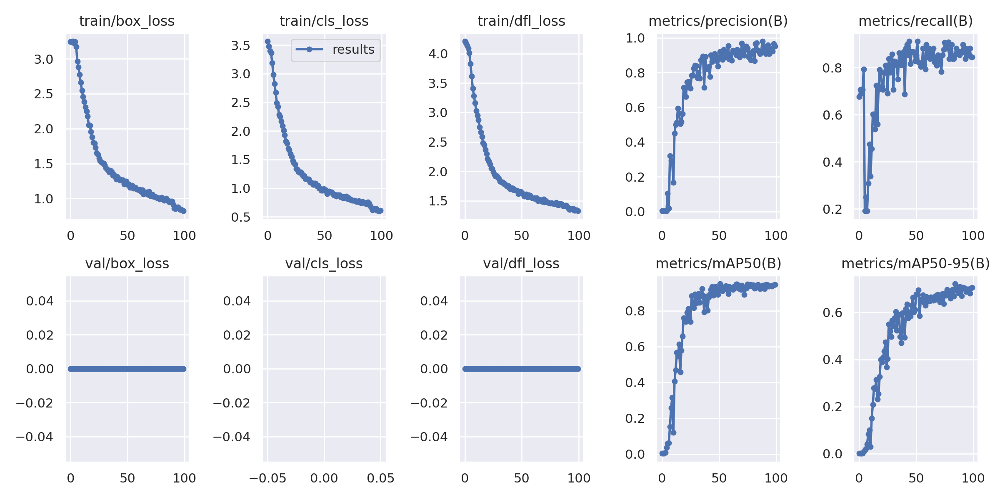

In [ ]:
Image(filename='/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/runs/detect/train/results.png')

In [ ]:
# making prediction on an image

!yolo task=detect mode=predict model=/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/runs/detect/train/weights/best.pt conf=0.25 source=/content/drive/MyDrive/general_assembly/capstone/image/sample1.jpg

2023-09-14 03:15:35.509377: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-14 03:15:36.497384: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
Model summary: 268 layers, 43607379 parameters, 0 gradients, 164.8 GFLOPs
image 1/1 /content/drive/MyDrive/general_assembly/capstone/image/sample1.jpg: 640x608 2 Norwich Terriers, 70.6ms
Speed: 0.8ms pre-process, 70.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict


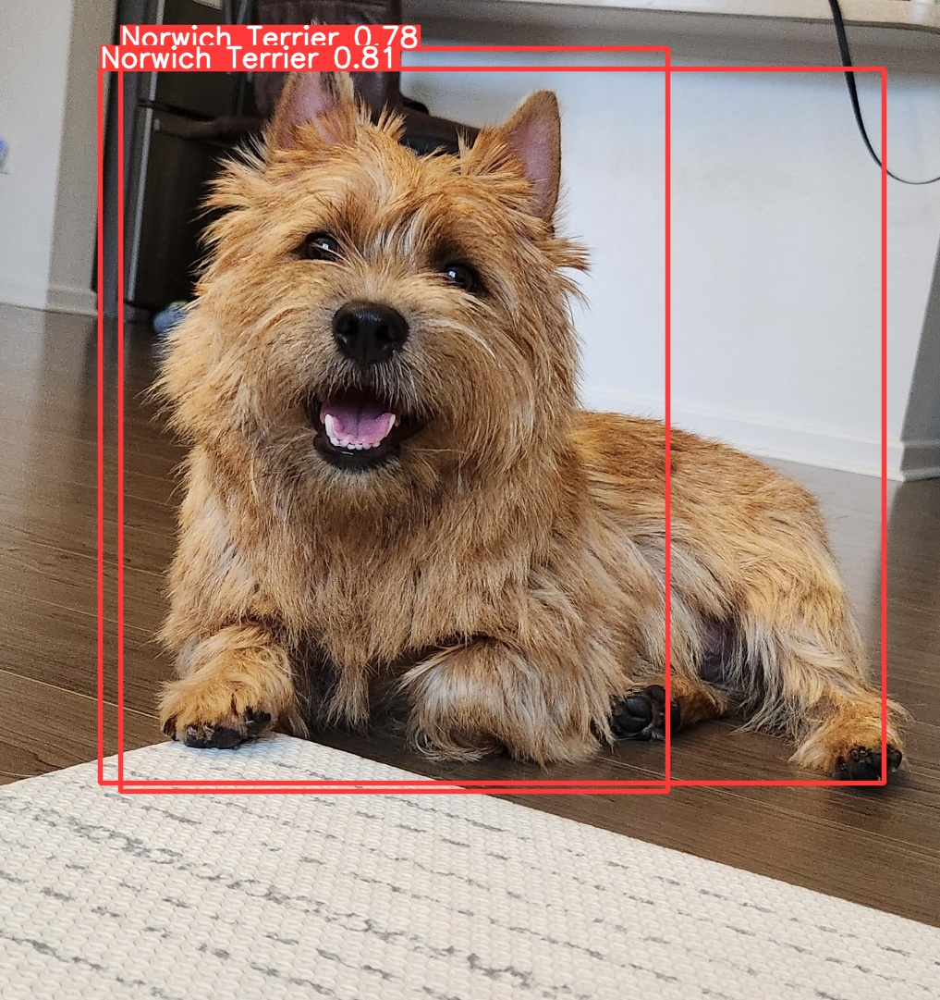

In [ ]:
# displaying image

Image('/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/runs/detect/predict/sample1.jpg', width=400)

In [ ]:
# making prediction on video - Sample 1

!yolo task=detect mode=predict model=/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/runs/detect/train/weights/best.pt conf=0.25 source=/content/drive/MyDrive/general_assembly/capstone/video/sample2_for_custom_data.mp4

2023-09-14 03:18:44.979843: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-14 03:18:45.998342: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
Model summary: 268 layers, 43607379 parameters, 0 gradients, 164.8 GFLOPs
video 1/1 (1/115) /content/drive/MyDrive/general_assembly/capstone/video/sample2_for_custom_data.mp4: 640x384 1 Norwich Terrier, 71.3ms
video 1/1 (2/115) /content/drive/MyDrive/general_assembly/capstone/video/sample2_for_custom_data.mp4: 640x384 1 Norwich Terrier, 33.0ms
video 1/1 (3/115) /content/drive/MyDrive/general_assembly/capstone/video/sample2_for_custom_data.mp4: 640x

In [ ]:
# Input video path
save_path = '/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/runs/detect/predict3/sample2_for_custom_data.mp4'

# Compressed video path
compressed_path = "/content/drive/MyDrive/general_assembly/capstone/assets/obj_det_cd_video_v2.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
# making prediction on video - Sample 2

!yolo task=detect mode=predict model=/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/runs/detect/train/weights/best.pt conf=0.50 source=/content/drive/MyDrive/general_assembly/capstone/video/sample5.mp4

2023-09-14 19:28:31.365764: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-14 19:28:32.458560: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
Model summary: 268 layers, 43607379 parameters, 0 gradients, 164.8 GFLOPs
video 1/1 (1/491) /content/drive/MyDrive/general_assembly/capstone/video/sample5.mp4: 640x384 1 Norwich Terrier, 72.1ms
video 1/1 (2/491) /content/drive/MyDrive/general_assembly/capstone/video/sample5.mp4: 640x384 1 Norwich Terrier, 33.1ms
video 1/1 (3/491) /content/drive/MyDrive/general_assembly/capstone/video/sample5.mp4: 640x384 1 Norwich Terrier, 33.1ms
video 1/1 (4/491) /content

In [1]:
#### Output deleted to reduce file size ####


# save_path = '/content/drive/MyDrive/general_assembly/capstone/object_detection_custom_data_v2/runs/detect/predict8/sample5.mp4'

# compressed_path = "/content/drive/MyDrive/general_assembly/capstone/assets/obj_det_cd_video_v3.mp4"

# os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# mp4 = open(compressed_path,'rb').read()
# data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# HTML("""
# <video width=400 controls>
#       <source src="%s" type="video/mp4">
# </video>
# """ % data_url)

## **Task2: Conclusion**

The second YOLOv8 model, trained exclusively on Norwich Terrier images, not only effectively detected Norwich Terriers in both images and videos but also distinguished them from other dog breeds, achieving an impressive mAP50 score of 0.947. This enhanced model performance can be attributed to various factors:

- Utilizing a more advanced and comprehensive model (YOLOv8l) compared to the
initial iterations (YOLOv8m).
- Increasing the number of training epochs from 70 to 100.
- Expanding the dataset with a larger number of images.
- Applying more sophisticated data augmentation techniques.
- Focusing the training exclusively on Norwich Terriers without introducing other breeds, which allowed the model to learn more effectively.

-----